<a href="https://colab.research.google.com/github/gmin7/pconv_implementation/blob/master/pconv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Loss Functions



# NVIDIA's Inpainting Paper

Original paper: https://arxiv.org/pdf/1804.07723.pdf



## Import Libraries and Define Global Paths

In [ ]:
# Import Libraries

import torch
import os
import cv2
import glob
import random
import matplotlib.pyplot as plt
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from   torchvision import models
from   torchvision import transforms
# from   places2_train import Places2Data, MEAN, STDDEV
from   PIL import Image
import PIL.ImageOps    
from   IPython.display import display # to display images

from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
from torch.utils.data import DataLoader
from torch.utils.data.sampler import SubsetRandomSampler

ROOT_PATH          = "/content/gdrive"
PROJECT_PATH       = ROOT_PATH    + "/My Drive/Colab Notebooks/NVIDIA_Inpainting"
PLACES2_PATH       = PROJECT_PATH + "/places2_val256"
MASKS_PATH         = PROJECT_PATH + "/masks"
MINI_PLACES2_PATH  = PROJECT_PATH + "/mini_places2_val256"
MINI_MASKS_PATH    = PROJECT_PATH + "/mini_masks"
MODEL_BACKUP_PATH  = PROJECT_PATH + "/backups"

## Sample Generator

In [ ]:
'''
Class that generates a triple (masked input, mask, and gt)
'''
# Mount Drive
from google.colab import drive
drive.mount(ROOT_PATH)

class Places2_Sampler:
    def __init__(self, path_to_data=PLACES2_PATH, path_to_masks=MASKS_PATH):
        self.tfm                  = transforms.ToTensor() # Ref code normalizes gt upon load but here we omit that
        self.path_to_data         = glob.glob( path_to_data  + "/**/*.jpg",  recursive=True )
        self.path_to_masks        = glob.glob( path_to_masks + "/**/*.png",  recursive=True )
        self.index_min            = 0
        self.index_max            = len(self.path_to_data)

    def __getitem__(self, index):
        assert index<=self.index_max and index>=self.index_min, 'Index out of range for mini dataset'
        gt_img            = Image.open(self.path_to_data[index]).convert('RGB')
        mask_img          = Image.open(self.path_to_masks[random.randint(1, self.index_max)]).resize((256,256))
        mask_inverted_img = PIL.ImageOps.invert( mask_img )
        gt                = self.tfm(gt_img)
        mask              = self.tfm(mask_inverted_img.convert('RGB'))      
        return gt*mask, mask, gt

def unit_test_generator(use_mini):
    sampler = Places2_Sampler( \
                (MINI_PLACES2_PATH if use_mini else PLACES2_PATH), \
                (MINI_MASKS_PATH   if use_mini else MASKS_PATH) \
              )
    print('number of images available: ', sampler.index_max)
    x, m, gt = sampler.__getitem__(1)

unit_test_generator(True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive
number of images available:  10


## Mount Drive and define mini dataloaders

In [ ]:
'''
for filename in os.listdir(PLACES2_PATH):
    if filename.endswith("jpg"): 
        print(filename)

@param batch_size (Pos Integer)
@param use_mini   (Boolean)
'''
def get_data_loaders(batch_size, use_mini):
    places2 = Places2_Sampler( \
                (MINI_PLACES2_PATH if use_mini else PLACES2_PATH), \
                (MINI_MASKS_PATH   if use_mini else MASKS_PATH) \
              )

    # Dataset split param definition
    validation_split = .2 # If indexmax == 10, 8 iters will occur over training data, 2 over val
    shuffle_dataset  = True
    random_seed      = 5
    dataset_size     = places2.index_max

    # Shuffle and split
    indices          = list(range(dataset_size)) 
    split            = int(np.floor(validation_split * dataset_size))
    if shuffle_dataset :
        np.random.seed(random_seed)
        np.random.shuffle(indices)
    train_indices, val_indices = indices[split:], indices[:split]

    # Create sampler and loaders
    train_sampler = SubsetRandomSampler(train_indices)
    val_sampler   = SubsetRandomSampler(val_indices)  
    train_loader  = torch.utils.data.DataLoader(places2, 
                                                batch_size  = batch_size,
                                                num_workers = 1, 
                                                sampler     = train_sampler)
    
    val_loader    = torch.utils.data.DataLoader(places2, 
                                                batch_size  = batch_size,
                                                num_workers = 1, 
                                                sampler     = val_sampler)

    return train_loader, val_loader


def unit_test_dataloader():
    bs = 2
    t_loader, v_loader = get_data_loaders(bs, True)
    t = 1 # max t is (0.8*index_max / bs)
    for x, m, gt in iter(t_loader):
        print(t)
        t+=1

unit_test_dataloader()

1
2
3
4


## Loss functions implementation

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 186MB/s]


--------- 1
i_comp: 


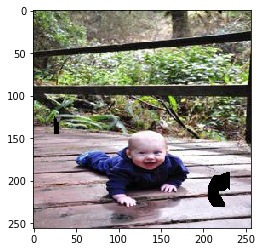

KEY: valid | VALUE: 0.0
KEY: hole | VALUE: 0.04650839418172836
KEY: perceptual | VALUE: 0.015765151008963585
KEY: style_out | VALUE: 0.13760820031166077
KEY: style_comp | VALUE: 0.13760820031166077
KEY: style_tv | VALUE: 0.010820078663527966
KEY: total_loss | VALUE: 0.34831005334854126
--------- 2
i_comp: 


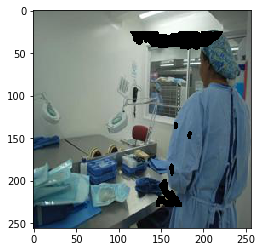

KEY: valid | VALUE: 0.0
KEY: hole | VALUE: 0.10970991849899292
KEY: perceptual | VALUE: 0.030412649735808372
KEY: style_out | VALUE: 0.2948692739009857
KEY: style_comp | VALUE: 0.2948692739009857
KEY: style_tv | VALUE: 0.005498528480529785
KEY: total_loss | VALUE: 0.7353596687316895
--------- 3
i_comp: 


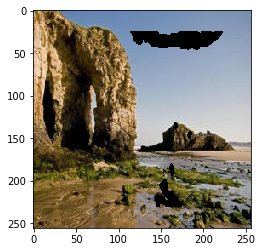

KEY: valid | VALUE: 0.0
KEY: hole | VALUE: 0.08700098097324371
KEY: perceptual | VALUE: 0.030657470226287842
KEY: style_out | VALUE: 0.30855193734169006
KEY: style_comp | VALUE: 0.30855193734169006
KEY: style_tv | VALUE: 0.008468435145914555
KEY: total_loss | VALUE: 0.7432307600975037
--------- 4
i_comp: 


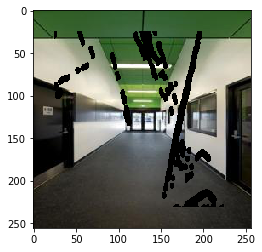

KEY: valid | VALUE: 0.0
KEY: hole | VALUE: 0.23771262168884277
KEY: perceptual | VALUE: 0.09031388908624649
KEY: style_out | VALUE: 0.8348039984703064
KEY: style_comp | VALUE: 0.8348039984703064
KEY: style_tv | VALUE: 0.006308244075626135
KEY: total_loss | VALUE: 2.0039427280426025


In [ ]:
'''
Compute total loss defined by 6 loss functions
'''

WEIGHTS = {
    "valid"      : 1.0,
    "hole"       : 6.0,
    "perceptual" : 0.05,
    "style"      : 120,
    "tv"         : 0.1,
}


MEAN   = [0.485, 0.456, 0.406]
STDDEV = [0.229, 0.224, 0.225]

# Resize mask from 512x512 to 256x256
def resize_mask(mask):
    # print('dimension of original mask is: ', mask.shape) # should return width, height
    res = cv2.resize(mask, dsize=(256, 256), interpolation=cv2.INTER_CUBIC)
    # print('resized image: ', res.shape)
    return res

# Plot the image here using matplotlib.
def plot_image(tensor, message=None):
    if(message != None):
        print(message)
    plt.figure()
    # imshow needs a numpy array with the channel dimension
    # as the the last dimension so we have to transpose things.
    plt.imshow(tensor.detach().numpy().transpose(1, 2, 0))
    plt.show()

'''
@param i_out (Tensor)
@param i_gt  (Tensor)
@param mask  (Tensor)
@returns {Tensor}
'''
def get_i_comp(i_out, i_gt, mask):
    i_comp = i_out*(1-mask) + i_gt*mask
    plot_image(i_comp[0, 0:3, :, :], 'i_comp: ')
    return i_comp

class VGG16_Projector(nn.Module):
    def __init__(self):
        super().__init__()
        vgg16 = models.vgg16(pretrained=True) 

        self.allChildren  = vgg16.features
        self.max_pooling1 = vgg16.features[:5]
        self.max_pooling2 = vgg16.features[5:10]
        self.max_pooling3 = vgg16.features[10:17]
        
        for i in range(1, 4):
            for param in getattr(self, 'max_pooling{:d}'.format(i)).parameters():
                param.requires_grad = False
    
    def forward(self, image):
        feature_representation = [image]
        for i in range(1, 4):
            subnetwork = getattr(self, 'max_pooling{:d}'.format(i))
            feature_representation.append(subnetwork(feature_representation[-1]))
            # print('feature representation ', feature_representation)
        # Return list with each item being a feature map from each of the 3 maxpool layers
        return feature_representation[1:]
    
class Compute_Loss(nn.Module):
    def __init__(self):
        super().__init__()
        self.vgg16 = VGG16_Projector()
        self.l1    = nn.L1Loss()
    
    # Taken from reference code
    def gram_matrix(self, feature_matrix):
        (batch, channel, h, w) = feature_matrix.size()
        feature_matrix         = feature_matrix.view(batch, channel, h * w)
        feature_matrix_t       = feature_matrix.transpose(1, 2)

        # batch matrix multiplication * normalization factor K_n
        # (batch, channel, h * w) x (batch, h * w, channel) ==> (batch, channel, channel)
        gram = torch.bmm(feature_matrix, feature_matrix_t) / (channel * h * w)
        # size = (batch, channel, channel)
        return gram
        
    '''
    @description : Computes l1 over all the channels of the images projected onto the VGG16 FS
    @param fs_* : Lists of feature maps from each of the pooling outputs from the VGG16 network (see projection definition)
    '''
    def perceptual_loss(self, fs_comp, fs_gt, fs_out):
        total_loss = 0.0
        for c in range( len(fs_comp) ):
            total_loss = total_loss + self.l1(fs_out[c], fs_gt[c])
            total_loss = total_loss + self.l1(fs_comp[c], fs_gt[c])
        return total_loss
    
    '''
    @description : Computes style loss between projected GT and either the composed or raw output
    '''
    def style_loss(self, fs_gt, fs_generated):
        total_loss = 0.0
        for c in range( len(fs_generated) ):
            # print(fs_generated[c])
            total_loss = total_loss + self.l1(self.gram_matrix(fs_generated[c]), self.gram_matrix(fs_gt[c]))
        return total_loss

    def total_variation(self, i_comp):
        return (
            torch.sum( self.l1(i_comp[:, :, :, :-1], i_comp[:, :, :, 1:]) ) + 
            torch.sum( self.l1(i_comp[:, :, :-1, :], i_comp[:, :, 1:, :]) )
        )

    # All inputs are Tensors
    def forward(self, i_out, i_gt, mask):
        i_comp  = get_i_comp(i_out, i_gt, mask)
        fs_comp = self.vgg16(i_comp)
        fs_gt   = self.vgg16(i_gt)
        fs_out  = self.vgg16(i_out)
        
        l_valid       = self.l1(mask*i_out, mask*i_comp) * WEIGHTS['valid']
        l_hole        = self.l1((1-mask)*i_out, (1-mask)*i_gt) * WEIGHTS['hole']
        l_perceptual  = self.perceptual_loss(fs_comp, fs_gt, fs_out) * WEIGHTS['perceptual']
        l_style_out   = self.style_loss(fs_gt, fs_out) * WEIGHTS['style']
        l_style_comp  = self.style_loss(fs_gt, fs_comp) * WEIGHTS['style']
        l_tv          = self.total_variation(i_comp) * WEIGHTS['tv']
        total_loss    = l_valid+l_hole+l_perceptual+l_style_out+l_style_out+l_tv
        return {
            'valid'         : l_valid,
            'hole'          : l_hole,
            'perceptual'    : l_perceptual,
            'style_out'     : l_style_out,
            'style_comp'    : l_style_comp,
            'style_tv'      : l_tv,
            'total_loss'    : total_loss,
        }
    

# Unit Test
def loss_unit_test():
    loss_func = Compute_Loss()
    gt = cv2.imread(PLACES2_PATH + "/Places365_val_00000050.jpg")
    mask = cv2.imread(MASKS_PATH + "/00000.png") #natively an ndarray, so we can use toTensor as we do for Image type

    # resize to be 256x256 to match gt dims
    mask = resize_mask(mask)
    tfm = transforms.ToTensor()
    
    gt   = tfm(gt)
    mask = tfm(mask)
    img = gt * mask

    # Expand to 4d for forward in vgg16, just for unit test, check for dataloader which has batch dimension
    img.unsqueeze_(0)
    mask.unsqueeze_(0)
    gt.unsqueeze_(0)
    
    # Now project gt_t into vgg16 feature space
    vgg16 = VGG16_Projector()
    fs_gt = vgg16(gt)
    loss_out = loss_func(gt, img, mask)

    for key, value in loss_out.items():
        print("KEY: {} | VALUE: {}".format(key, value))

    
def loss_and_dataloader_unit_test():
    bs = 2
    loss_func = Compute_Loss()
    t_loader, v_loader = get_data_loaders(bs, True)
    t = 1 # max t is (0.8*index_max / bs)
    for x, m, gt in iter(t_loader):
        print('---------', t)
        loss_out = loss_func(x, gt, m)
        for key, value in loss_out.items():
            print("KEY: {} | VALUE: {}".format(key, value))
        t+=1

loss_and_dataloader_unit_test()

## PConv Layer

In [ ]:
'''
@description: Partial Convolution and update of the provided mask

@param in_channels  (Integer)  : Depth of x and m
@param out_channels (Integer)  : Depth of output x_prime and m_prime
@param kernel_size  (Integer)  : Width of the filter in pconv
@param bn           (Boolean)  : Whether to apply bn to output of pconv
@param bias         (Boolean)  : Whether to apply bias to pconv on x
@param nonlinearity (String)   : Whether to apply 'relu' or 'leaky_relu'

@param x            (Tensor)   : Input feature map (depth = in_channels)
@param m            (Tensor)   : Mask for x        (depth = in_channels)

@ret   x_prime      (Tensor)   : (M_sum > 0) ? (W^T dot (X .* M) + b - b) / M_sum + b : 0
@ret   m_prime      (Tensor)   : 

'''
class PConvLayer(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, bn, bias, activation):
        super(PConvLayer, self).__init__() # Initialize the base class
        if(kernel_size==7):
            padding = 3
            stride = 2
        elif(kernel_size==5):
            padding = 2
            stride = 2
        elif(kernel_size==3 and activation=='relu'):
            padding = 1
            stride = 2
        else:
            padding = 1
            stride = 1

        # Define the fm and mask convolutions (Stride=2, Padding=1)
        self.xconv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=bias) 
        self.mconv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False)

        # Initialize the mask weights
        nn.init.constant_(self.mconv.weight, 1.0)
        for param in self.mconv.parameters():
            param.requires_grad = False

        # Initialize x's weights based on "Delving Deep into Rectifiers: 
        # Surpassing Human-Level Performance on ImageNet Classification"
        # fan_out means we preserve the magnitude of the variance of the weights in the back prop
        nn.init.kaiming_normal_(self.xconv.weight, mode='fan_out', nonlinearity='relu')
        #nn.init.kaiming_normal_(self.input_conv.weight, a=0, mode="fan_in")
        
        self.bn = bn
        if bn:
            self.batch_normalization = nn.BatchNorm2d(out_channels)

        if activation == "relu":
            self.activation = nn.ReLU()
        elif activation == "leaky_relu":
            self.activation = nn.LeakyReLU(negative_slope=0.2)

    def forward(self, x, m):
        # plot_image(m[0,0:3,:,:], 'input m')
        # print(m.shape)
        # print('x: ', x)
        # X' = W^T dot X.*M + b
        x_prime = self.xconv(x*m)
        # print('x_prime: ', x_prime)
        # plot_image(x_prime[0,0:3,:,:], 'stage 1')
        
        # Threshold x_prime to be nonnegative
        if self.xconv.bias is not None:
            applied_bias = self.xconv.bias.view(1, -1, 1, 1)
            bias_prime   = applied_bias.expand_as(x_prime)
            # print('bias prime shape: ', bias_prime.shape)
            # print(bias_prime)
            # plot_image(bias_prime[0,0:3,:,:], 'bias prime: ')
        else:
            bias_prime = torch.zeros(x_prime.shape)

        # Get the new mask
        with torch.no_grad():
            m_prime = self.mconv(m) # m_prime = (1 dot M) + 0 = M
        # print('m_prime')
        # print(m_prime)
        # plot_image(m_prime[0,0:3,:,:], 'm_prime')

        # m_prime is a matrix of shape x_prime.shape with entries being sum(M) as defined in eqn(1) from inpainting paper
        mprime_is_zero = (m_prime == 0.0)  # Tensor with Boolean entries
        # print('mprime_is_zero type: ', type(mprime_is_zero))
        # print(mprime_is_zero)
        assert mprime_is_zero.shape==x_prime.shape, 'mprime_is_zero dimensions does not match x_prime'

        # Eqn(1) from paper; Don't want to divide by zero so set all 0 values to one
        mp_dividable = m_prime.masked_fill_(mprime_is_zero, 1.0) 
        mp_dividable = mp_dividable / 255
        # plot_image(mp_dividable[0,0:3,:,:])
        # plot_image((x_prime - bias_prime)[0,0:3,:,:], '(x_prime - bias_prime)')

        xp_scaled    = (x_prime - bias_prime) / mp_dividable + bias_prime
        # plot_image(xp_scaled[0, 0:3, :, :], 'xp_scaled')

        x_out = xp_scaled.masked_fill_(mprime_is_zero, 0.0)

        # Now put m_prime in its final form by replacing the sum(M) with 1.0 where sum(M) != 0
        assert m_prime.shape == x_out.shape
    
        # Output mask is 1 where SUM(M)>0 and 0 if SUM(M)==0
        m_out = torch.ones_like(m_prime)
        m_out = m_out.masked_fill_(mprime_is_zero, 0.0)

        # Apply BN and activation if present
        if self.bn:
            x_out = self.batch_normalization(x_out)
        if hasattr(self, 'activation'):
            x_out = self.activation(x_out)

        return x_out, m_out


'''
Unit test for pconv layer
We'll create the first pconv following the archtiecture here: https://arxiv.org/pdf/1804.07723.pdf pg.18
'''
def pconv_layer_unit_test():
    from google.colab.patches import cv2_imshow

    in_channels  = 3
    out_channels = 3
    kernel_size  = 3
    bn           = False
    bias         = True
    activation   = 'relu'
    layer = PConvLayer(in_channels, out_channels, kernel_size, bn, bias, activation)

    tfm = transforms.ToTensor()
    
    gt    = cv2.imread(PLACES2_PATH + "/Places365_val_00000050.jpg")
    mask  = cv2.imread(MASKS_PATH   + "/00000.png") #natively an ndarray, so we can use toTensor as we do for Image type

    # Resize mask to be 256x256 to match gt dims
    mask = np.invert(resize_mask(mask))

    # Get initial input to network
    m_initial    = tfm(mask)
    mask_is_zero = (m_initial == 0)
    x_initial    = tfm(gt).masked_fill_(mask_is_zero, 0.0)
    # plot_image(x_initial)

    x_p, m_p   = layer(x_initial.view(1, -1, 256, 256), m_initial.view(1, -1, 256, 256))
    x_p, m_p   = layer(x_p.view(1, -1, 128, 128), m_p.view(1, -1, 128, 128))
    x_p, m_p   = layer(x_p.view(1, -1, 64, 64), m_p.view(1, -1, 64, 64))

    plot_image(x_p[0])
    plot_image(m_p[0])
    
    
# pconv_layer_unit_test()


## UNET

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


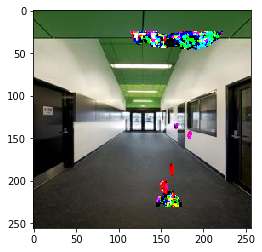

KEY:valid | VALUE:0.7240319848060608
KEY:hole | VALUE:1.0279831886291504
KEY:perceptual | VALUE:0.6344830393791199
KEY:style_out | VALUE:90.9075698852539
KEY:style_comp | VALUE:68.32477569580078
KEY:style_tv | VALUE:0.02573373354971409
KEY:total_loss | VALUE:184.22735595703125


In [ ]:
'''
Taken from the original architecture in the PDResNet from the NVIDIA source code
'''
class PConvNetwork(nn.Module):
    def __init__(self, mini_coder, input_size=256):
        super().__init__()
        if(mini_coder):
            # 3x256x256 --> 64x128x128
            self.encoder1 = PConvLayer(3, 64, 7, bn=False, bias=True, activation='relu')
            # (64+3)x256x256 --> 3x256x256
            self.decoder4 = PConvLayer(64+3, 3, 3, bn=False, bias=True, activation='none')
        else: 
            # 3x256x256 --> 64x128x128
            self.encoder1 = PConvLayer(3, 64, 7, bn=False, bias=True, activation='relu')
            # 64x128x128 --> 128x64x64
            self.encoder2 = PConvLayer(64, 128, 5, bn=True, bias=True, activation='relu')
            # 128x64x64 --> 256x32x32
            self.encoder3 = PConvLayer(128, 256, 3, bn=True, bias=True, activation='relu')
            # 256x32x32 --> 16x16x512
            self.encoder4 = PConvLayer(256, 512, 3, bn=True, bias=True, activation='relu')
            
            # (512+256)x32x32 --> 256x32x32
            self.decoder1 = PConvLayer(512+256, 256, 3, bn=True, bias=True, activation='leaky_relu')
            # (256+128)x64x64 --> 128x64x64
            self.decoder2 = PConvLayer(256+128, 128, 3, bn=True, bias=True, activation='leaky_relu')
            # (128+64)x128x128 --> 64x128x128
            self.decoder3 = PConvLayer(128+64, 64, 3, bn=True, bias=True, activation='leaky_relu')
            # (64+3)x256x256 --> 3x256x256
            self.decoder4 = PConvLayer(64+3, 3, 3, bn=False, bias=True, activation='none')

    def forward(self, input_x, input_m, mini_coder):
        if(mini_coder):
            e1_x, e1_m = self.encoder1(input_x, input_m)
            plot_image(e1_x[0, 0:3, :, :], 'e1_x:')

            d4_x = F.interpolate(e1_x, scale_factor=2)
            plot_image(d4_x[0, 0:3, :, :], 'd4_x: ')

            d4_m = F.interpolate(e1_m, scale_factor=2)
            d4_x = torch.cat([d4_x, input_x], dim=1)
            d4_m = torch.cat([d4_m, input_m], dim=1)
            d4_x, d4_m = self.decoder4(d4_x, d4_m)
            return d4_x, d4_m

        else:
            e1_x, e1_m = self.encoder1(input_x, input_m)
            # print(e1_x.shape)
            # plot_image(e1_m[0][:,:,0:3])
            e2_x, e2_m = self.encoder2(e1_x, e1_m)
            e3_x, e3_m = self.encoder3(e2_x, e2_m)
            e4_x, e4_m = self.encoder4(e3_x, e3_m)
            # plot_image(e4_x[0])

            d1_x = F.interpolate(e4_x, scale_factor=2)
            d1_m = F.interpolate(e4_m, scale_factor=2)   
            d1_x = torch.cat([d1_x, e3_x], dim=1)
            d1_m = torch.cat([d1_m, e3_m], dim=1)
            d1_x, d1_m = self.decoder1(d1_x, d1_m)
            # assert d1_x.shape==torch.Size([64, 256, 32, 32]), 'd4 output wrong dims'

            d2_x = F.interpolate(d1_x, scale_factor=2)
            d2_m = F.interpolate(d1_m, scale_factor=2)   
            d2_x = torch.cat([d2_x, e2_x], dim=1)
            d2_m = torch.cat([d2_m, e2_m], dim=1)
            d2_x, d2_m = self.decoder2(d2_x, d2_m)
            # assert d2_x.shape==torch.Size([64, 128, 64, 64]), 'd4 output wrong dims'

            d3_x = F.interpolate(d2_x, scale_factor=2)
            d3_m = F.interpolate(d2_m, scale_factor=2)   
            d3_x = torch.cat([d3_x, e1_x], dim=1)
            d3_m = torch.cat([d3_m, e1_m], dim=1)
            d3_x, d3_m = self.decoder3(d3_x, d3_m)
            # assert d3_x.shape==torch.Size([64, 64, 128, 128]), 'd4 output wrong dims'

            d4_x = F.interpolate(d3_x, scale_factor=2)
            d4_m = F.interpolate(d3_m, scale_factor=2)   
            d4_x = torch.cat([d4_x, input_x], dim=1)
            d4_m = torch.cat([d4_m, input_m], dim=1)
            d4_x, d4_m = self.decoder4(d4_x, d4_m)
            # plot_image(d4_m[0], 'output mask')
            # assert d4_x.shape==torch.Size([64, 3, 256, 256]), 'd4 output wrong dims'
            return d4_x, d4_m

def unit_test_unet():
    tfm                = transforms.ToTensor() # Bob normalizes gt upon load but here we omit that
    use_minicoder      = False
    network            = PConvNetwork(use_minicoder)

    img_transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize(MEAN, STDDEV)])
    mask_transform = transforms.ToTensor()
    
    path_to_data       = glob.glob( MINI_PLACES2_PATH  + "/**/*.jpg",  recursive=True )
    path_to_masks      = glob.glob( MINI_MASKS_PATH + "/**/*.png",  recursive=True )
    index_min          = 0
    index_max          = len(path_to_data)
    
    gt_img = Image.open(path_to_data[1]).convert('RGB')

    # print('gt_img normalized: ', img_transform(gt_img))
    # plot_image(img_transform(gt_img))

    # r, g, b = np.array(gt_img).T
    # print(tfm(gt_img).shape)
    # print('r: ', r)
    # print('g: ', g)
    # print('b: ', b)

    mask_img           = Image.open(path_to_masks[random.randint(1, index_max)]).resize((256,256))
    mask_inverted_img  = PIL.ImageOps.invert( mask_img )

    input_m = tfm(mask_inverted_img.convert('RGB'))  
    # print('input_m: ', input_m)
    input_x = tfm(gt_img)*input_m

    out_x, out_m = network(input_x.unsqueeze(0), input_m.unsqueeze(0), use_minicoder)
    loss_func = Compute_Loss()
    loss_out = loss_func(out_x, input_x.unsqueeze(0), input_m.unsqueeze(0))

    for key, value in loss_out.items():
        print("KEY:{} | VALUE:{}".format(key, value))

unit_test_unet()

## Train Loop

In [ ]:
'''
- Run for certain number of epochs
- For each epoch
    - Shuffle train loader
    - For each iter in train loader
        - Take gt, x, and m
        - Run through UNET
        - UNET spits out x
        - Compute Loss and print the values
        - Update the model
'''
def requires_grad(param):
	return param.requires_grad

def train(epochs, save_interval, resume_training, backup_name, mini_code):
    # Define the global objects / params
    bs                 = 2
    lr                 = 0.001
    model              = PConvNetwork(mini_code)
    loss_func          = Compute_Loss()
    t_loader, v_loader = get_data_loaders(bs, True)
    optimizer          = torch.optim.Adam(filter(requires_grad, model.parameters()), lr=lr)
    torch.autograd.set_detect_anomaly(True)
    t = 1000 # total update counter

    # Resume training check
    if resume_training:
        filename = MODEL_BACKUP_PATH + "/" + backup_name
        assert os.path.isfile(filename), "Model backup path is not a file"
        checkpoint_dict = torch.load(filename)
        model.load_state_dict(checkpoint_dict["model"])
        optimizer.load_state_dict(checkpoint_dict["optimizer"])
        print("Resume training on model:{}".format(backup_name))
        # Set global counter to resume
        t = int(backup_name.split('.')[0].split('i')[1])
    
    # Main training loop
    for e in range(epochs):
        for input_x, input_m, gt in iter(t_loader):
            print('----------- Epoch {}, Iter {}'.format(e, t))
            pred_x, pred_m = model(input_x, input_m, mini_code)
            # loss_out = loss_func(input_x.unsqueeze(0), out_x, input_m.unsqueeze(0))
            loss_out = loss_func(pred_x, gt, input_m)
            loss = loss_out['total_loss']

            # Resets gradient accumulator in optimizer
            # back-propogates gradients through model weights
            loss.backward()
            print('loss: {}'.format(loss))
            # updates the weights
            optimizer.step()
            optimizer.zero_grad()
   
            # save the model
            if(t%save_interval == 0):
                print('About to save a model...')
                filename = MODEL_BACKUP_PATH + "model_e{}_i{}.pth".format(e, t + 1)
                state = {"model": model.state_dict(), "optimizer": optimizer.state_dict()}
                torch.save(state, filename)
            t = t + 1

def unit_test_train():
    epochs            = 700
    save_interval     = 5   
    continue_training = True
    backup_name       = "model_ep690_i3761.pth"
    mini_code         = False

    train(epochs, save_interval, continue_training, backup_name, mini_code)

# unit_test_train()

## Load in a model

state
param_groups
Resume training on model:model_ep49_i3961.pth
Setting t to  3961
---------------------------- Epoch 0, Iter 3961


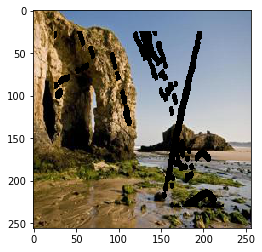

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


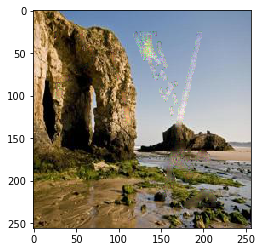

loss: 0.3026575744152069
---------------------------- Epoch 0, Iter 3962


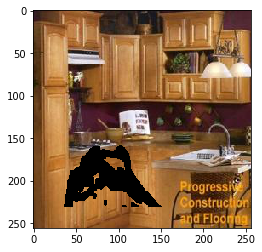

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


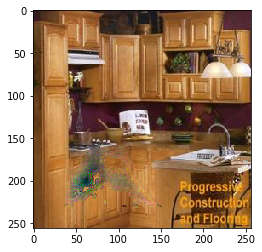

loss: 0.389317125082016
---------------------------- Epoch 0, Iter 3963


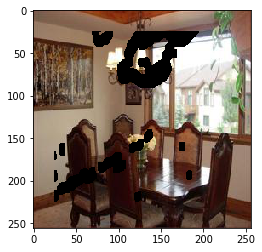

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


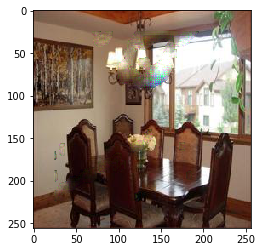

loss: 0.41634827852249146
---------------------------- Epoch 0, Iter 3964


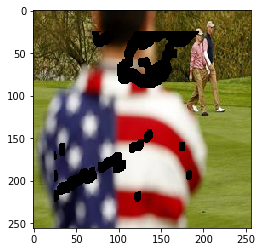

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


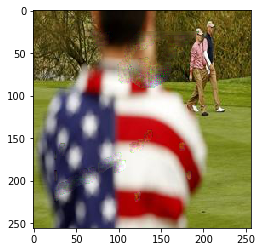

loss: 0.29696008563041687
---------------------------- Epoch 1, Iter 3965


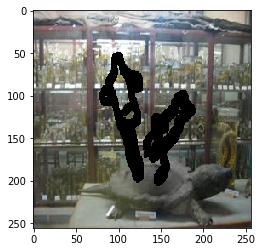

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


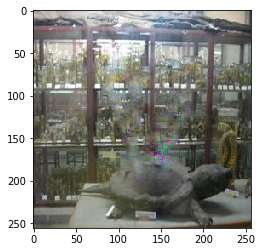

loss: 0.30245840549468994
About to save a model...
---------------------------- Epoch 1, Iter 3966


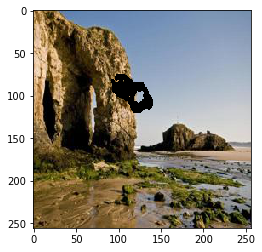

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


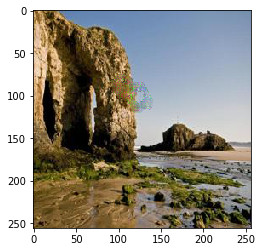

loss: 0.4280644655227661
---------------------------- Epoch 1, Iter 3967


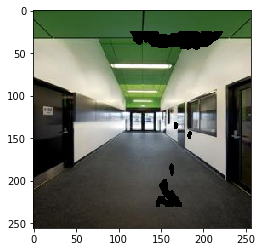

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


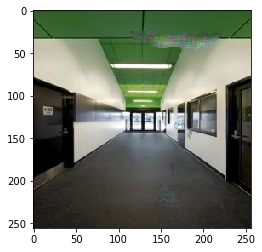

loss: 0.29833123087882996
---------------------------- Epoch 1, Iter 3968


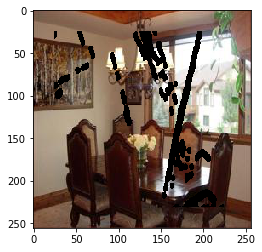

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


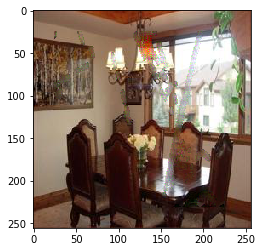

loss: 0.4037077724933624
---------------------------- Epoch 2, Iter 3969


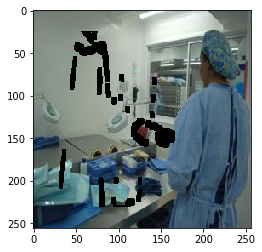

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


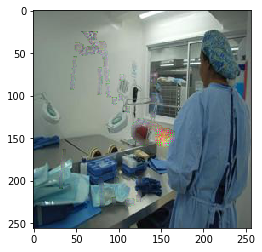

loss: 0.28827333450317383
---------------------------- Epoch 2, Iter 3970


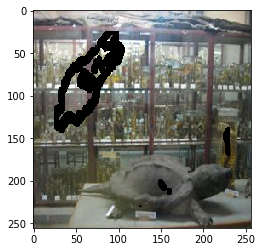

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


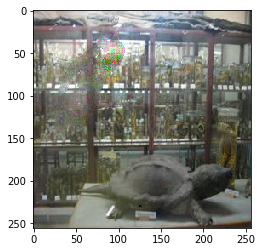

loss: 0.3097724914550781
About to save a model...
---------------------------- Epoch 2, Iter 3971


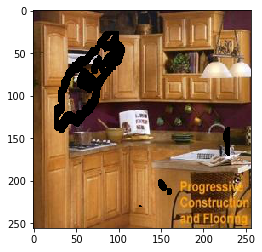

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


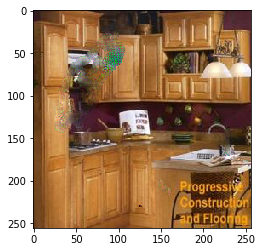

loss: 0.4001634120941162
---------------------------- Epoch 2, Iter 3972


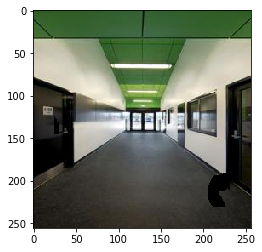

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


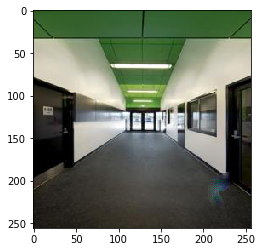

loss: 0.2527790069580078
---------------------------- Epoch 3, Iter 3973


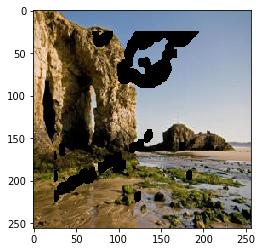

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


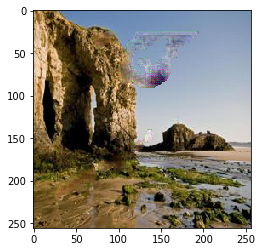

loss: 0.3805220127105713
---------------------------- Epoch 3, Iter 3974


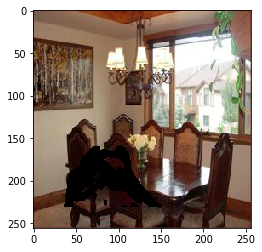

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


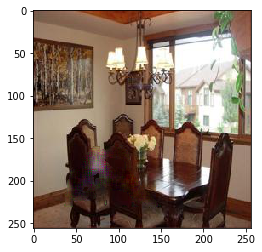

loss: 0.30992022156715393
---------------------------- Epoch 3, Iter 3975


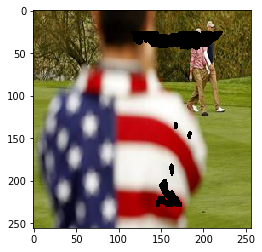

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


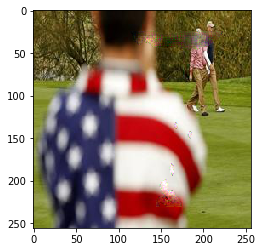

loss: 0.3191888928413391
About to save a model...
---------------------------- Epoch 3, Iter 3976


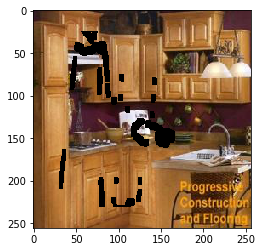

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


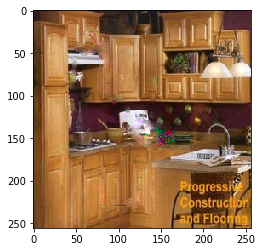

loss: 0.39596027135849
---------------------------- Epoch 4, Iter 3977


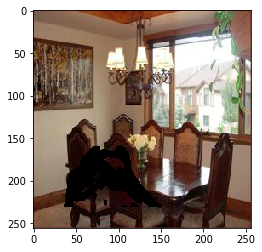

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


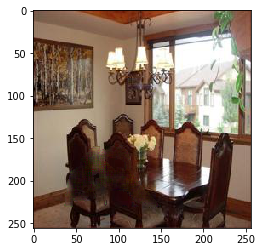

loss: 0.2871432900428772
---------------------------- Epoch 4, Iter 3978


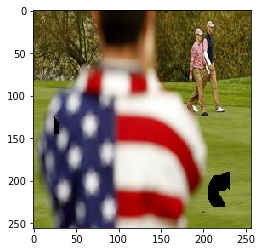

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


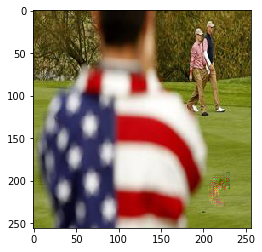

loss: 0.22382549941539764
---------------------------- Epoch 4, Iter 3979


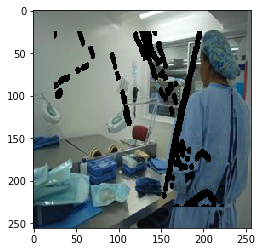

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


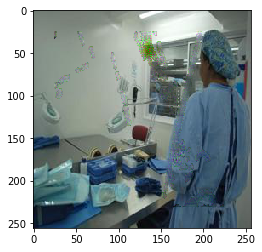

loss: 0.31365662813186646
---------------------------- Epoch 4, Iter 3980


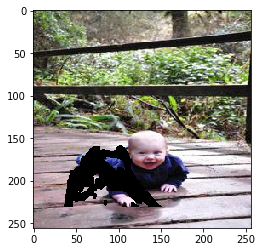

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


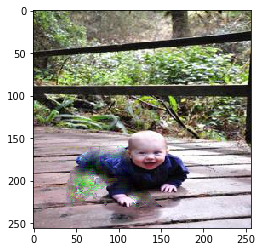

loss: 0.33008310198783875
About to save a model...
---------------------------- Epoch 5, Iter 3981


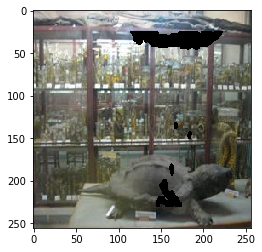

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


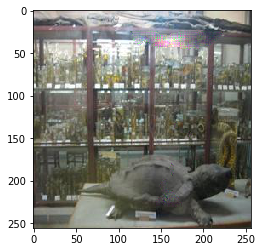

loss: 0.20687736570835114
---------------------------- Epoch 5, Iter 3982


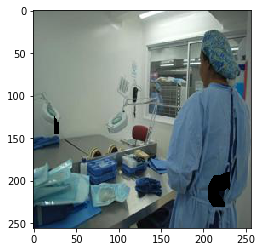

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


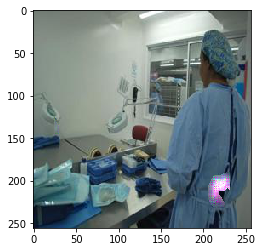

loss: 0.2577490210533142
---------------------------- Epoch 5, Iter 3983


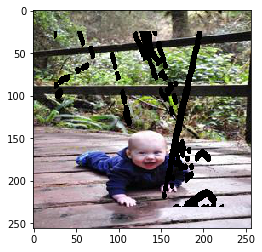

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


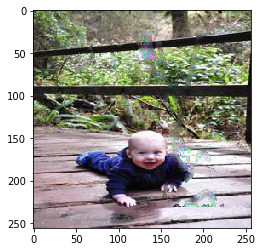

loss: 0.4392704665660858
---------------------------- Epoch 5, Iter 3984


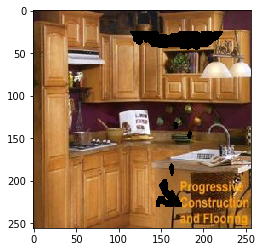

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


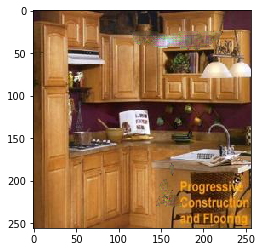

loss: 0.3362956643104553
---------------------------- Epoch 6, Iter 3985


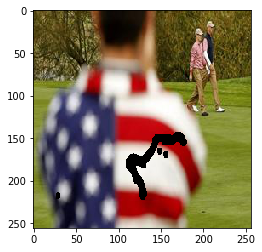

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


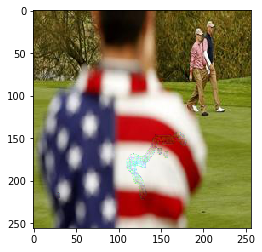

loss: 0.253063827753067
About to save a model...
---------------------------- Epoch 6, Iter 3986


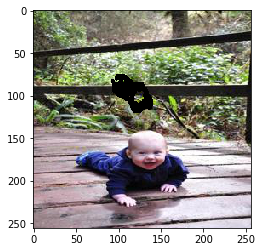

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


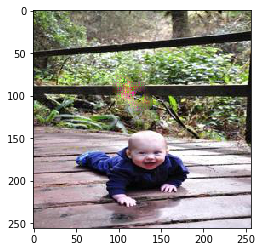

loss: 0.33474570512771606
---------------------------- Epoch 6, Iter 3987


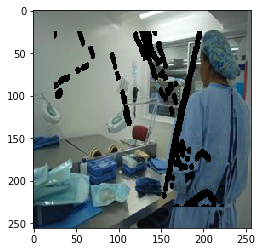

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


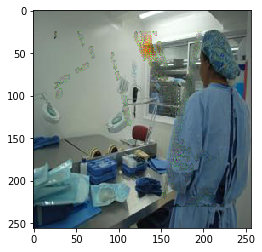

loss: 0.31336092948913574
---------------------------- Epoch 6, Iter 3988


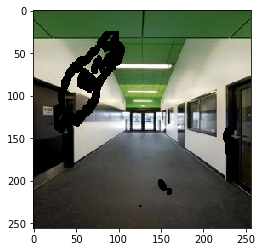

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


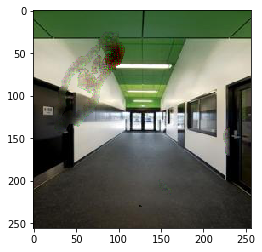

loss: 0.41865456104278564
---------------------------- Epoch 7, Iter 3989


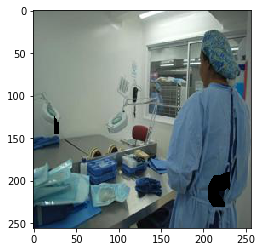

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


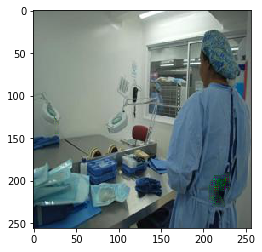

loss: 0.35751602053642273
---------------------------- Epoch 7, Iter 3990


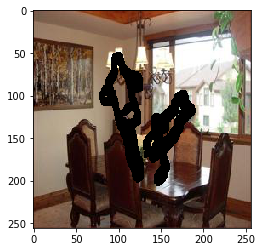

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


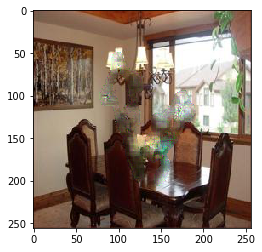

loss: 0.36685261130332947
About to save a model...
---------------------------- Epoch 7, Iter 3991


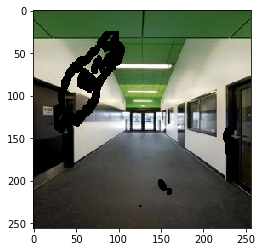

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


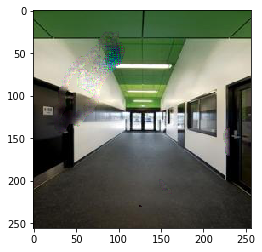

loss: 0.35526567697525024
---------------------------- Epoch 7, Iter 3992


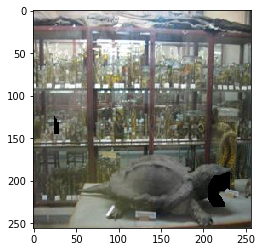

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


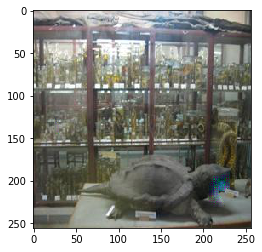

loss: 0.2958136796951294
---------------------------- Epoch 8, Iter 3993


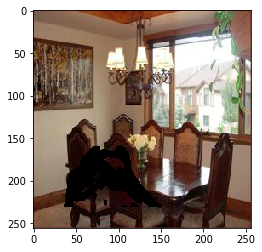

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


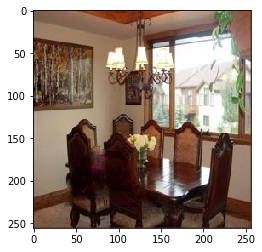

loss: 0.3865981698036194
---------------------------- Epoch 8, Iter 3994


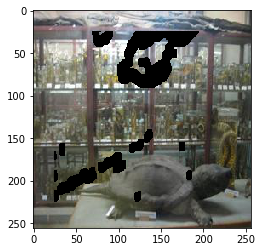

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


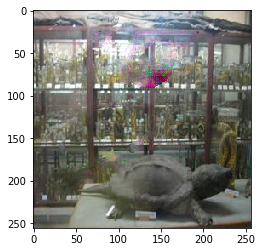

loss: 0.28732913732528687
---------------------------- Epoch 8, Iter 3995


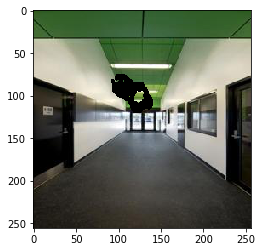

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


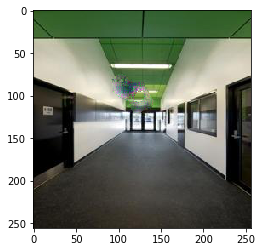

loss: 0.30499300360679626
About to save a model...
---------------------------- Epoch 8, Iter 3996


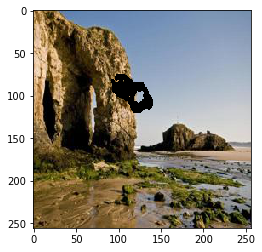

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


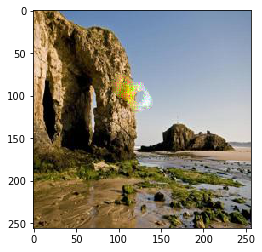

loss: 0.29012101888656616
---------------------------- Epoch 9, Iter 3997


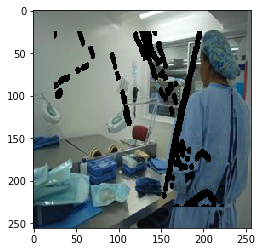

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


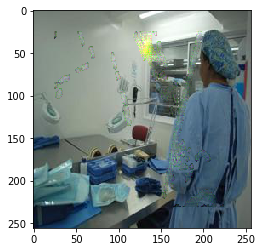

loss: 0.3676139712333679
---------------------------- Epoch 9, Iter 3998


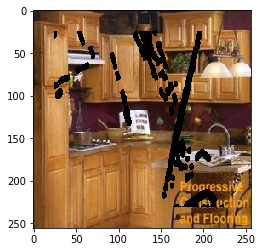

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


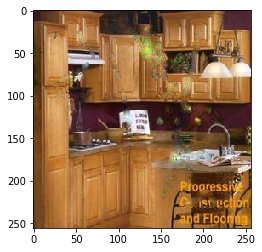

loss: 0.3471950888633728
---------------------------- Epoch 9, Iter 3999


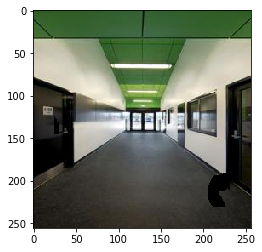

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


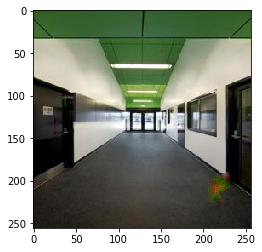

loss: 0.32051166892051697
---------------------------- Epoch 9, Iter 4000


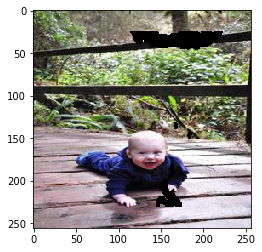

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


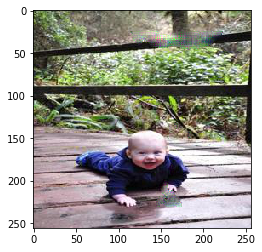

loss: 0.3454478085041046
About to save a model...
---------------------------- Epoch 10, Iter 4001


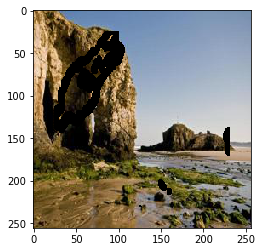

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


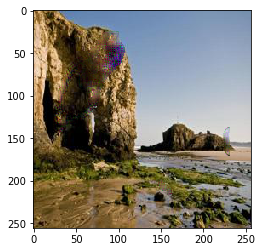

loss: 0.47898054122924805
---------------------------- Epoch 10, Iter 4002


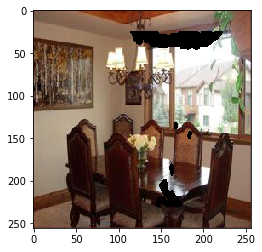

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


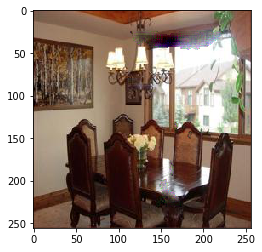

loss: 0.33517128229141235
---------------------------- Epoch 10, Iter 4003


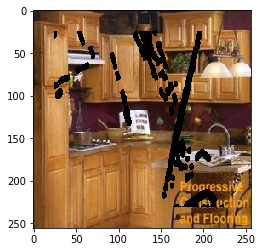

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


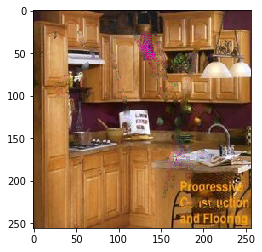

loss: 0.36634933948516846
---------------------------- Epoch 10, Iter 4004


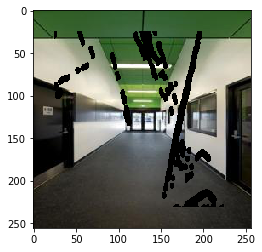

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


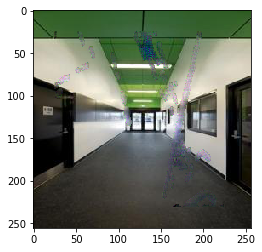

loss: 0.43455585837364197
---------------------------- Epoch 11, Iter 4005


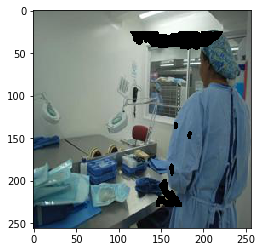

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


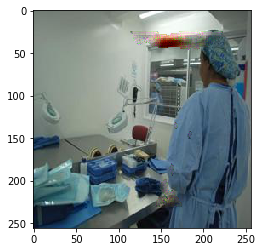

loss: 0.3571677505970001
About to save a model...
---------------------------- Epoch 11, Iter 4006


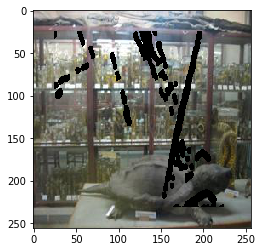

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


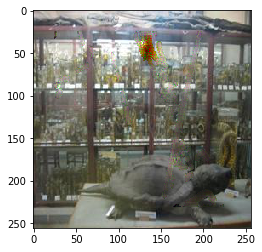

loss: 0.42381587624549866
---------------------------- Epoch 11, Iter 4007


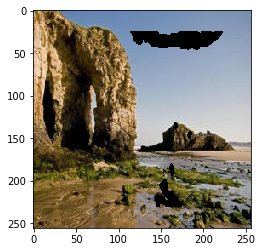

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


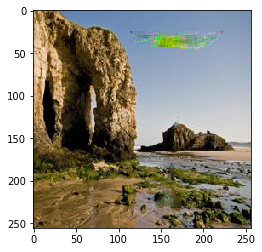

loss: 0.40582549571990967
---------------------------- Epoch 11, Iter 4008


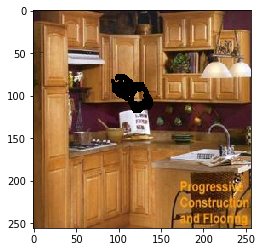

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


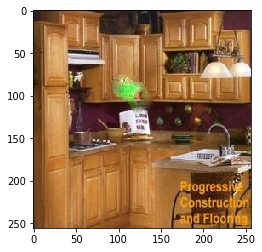

loss: 0.2885350286960602
---------------------------- Epoch 12, Iter 4009


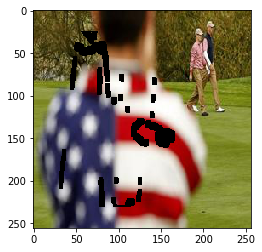

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


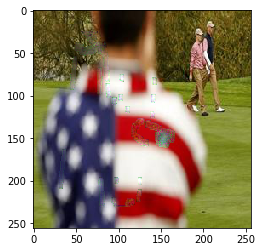

loss: 0.3726629912853241
---------------------------- Epoch 12, Iter 4010


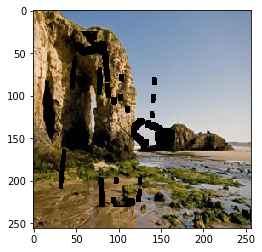

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


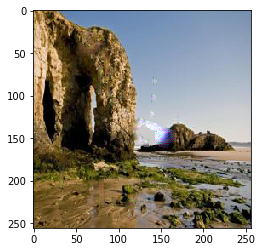

loss: 0.3093247711658478
About to save a model...
---------------------------- Epoch 12, Iter 4011


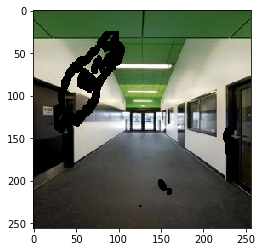

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


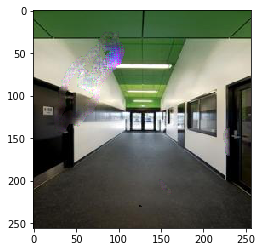

loss: 0.4293675422668457
---------------------------- Epoch 12, Iter 4012


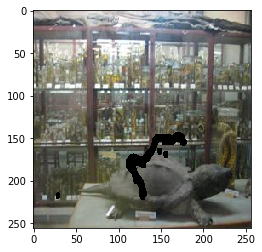

i_comp: 


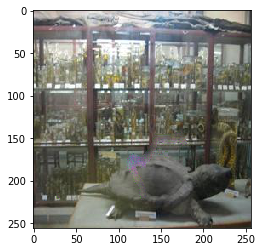

loss: 0.26586881279945374
---------------------------- Epoch 13, Iter 4013


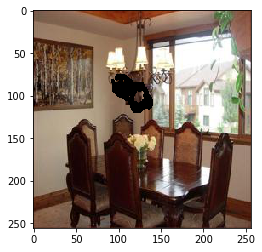

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


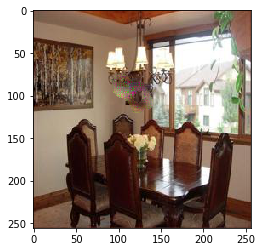

loss: 0.29416078329086304
---------------------------- Epoch 13, Iter 4014


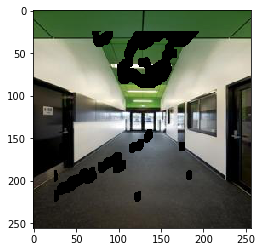

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


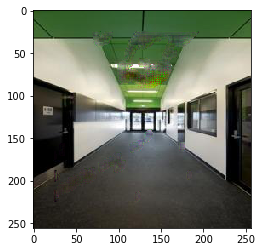

loss: 0.30670595169067383
---------------------------- Epoch 13, Iter 4015


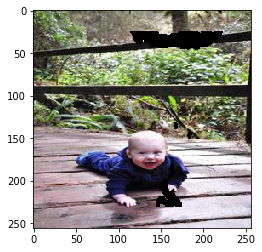

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


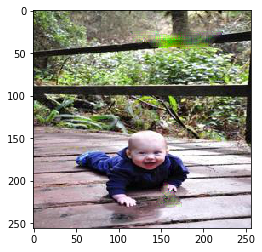

loss: 0.3010720908641815
About to save a model...
---------------------------- Epoch 13, Iter 4016


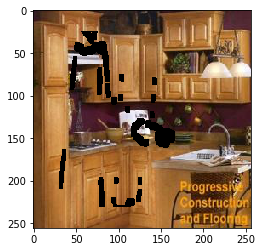

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


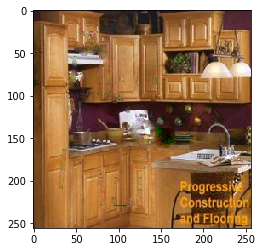

loss: 0.36646124720573425
---------------------------- Epoch 14, Iter 4017


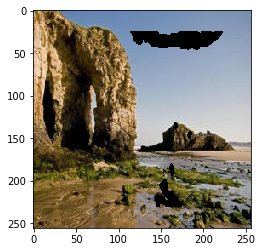

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


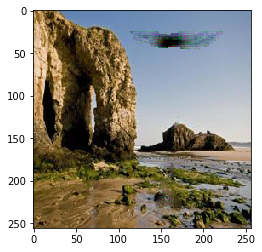

loss: 0.34420639276504517
---------------------------- Epoch 14, Iter 4018


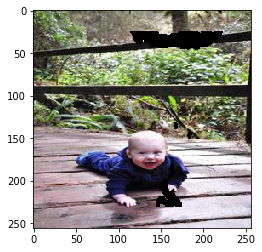

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


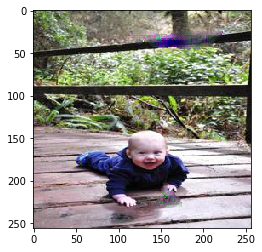

loss: 0.3014194369316101
---------------------------- Epoch 14, Iter 4019


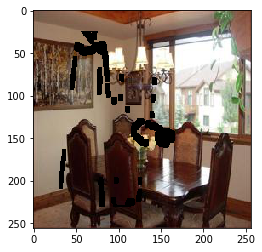

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


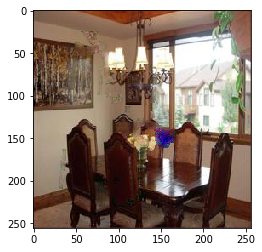

loss: 0.3692537248134613
---------------------------- Epoch 14, Iter 4020


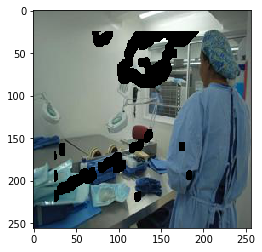

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


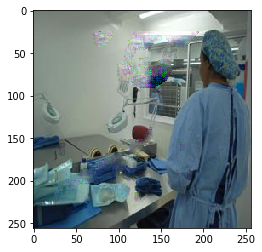

loss: 0.3255969285964966
About to save a model...
---------------------------- Epoch 15, Iter 4021


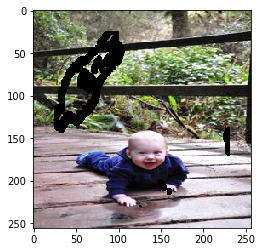

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


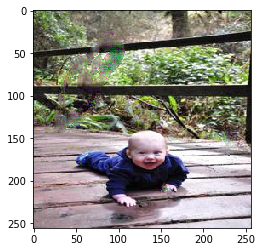

loss: 0.3855826258659363
---------------------------- Epoch 15, Iter 4022


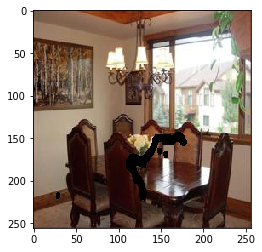

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


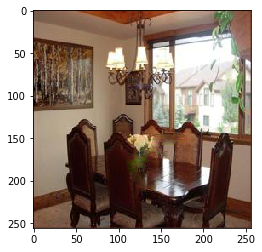

loss: 0.25387895107269287
---------------------------- Epoch 15, Iter 4023


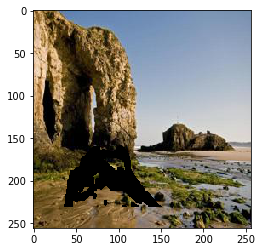

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


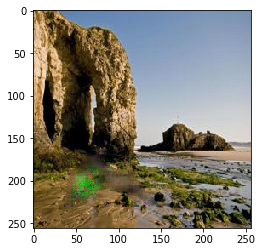

loss: 0.4191751778125763
---------------------------- Epoch 15, Iter 4024


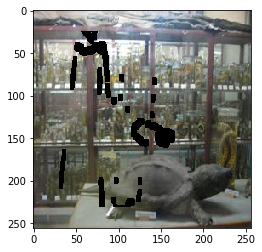

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


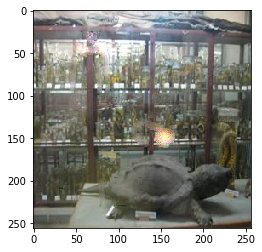

loss: 0.33748888969421387
---------------------------- Epoch 16, Iter 4025


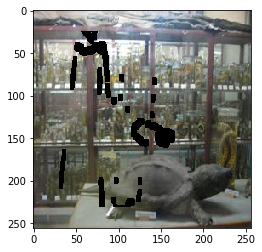

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


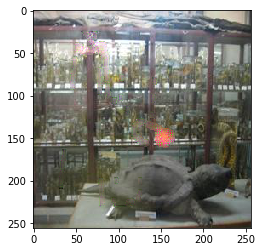

loss: 0.3855474293231964
About to save a model...
---------------------------- Epoch 16, Iter 4026


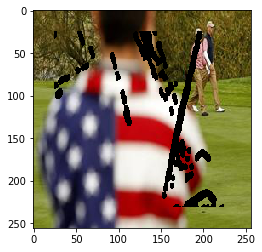

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


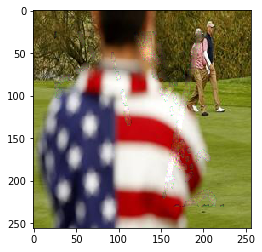

loss: 0.359968900680542
---------------------------- Epoch 16, Iter 4027


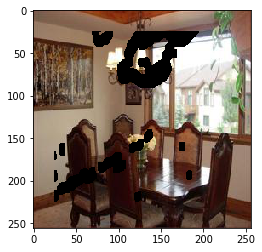

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


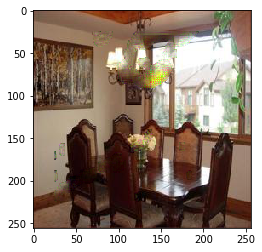

loss: 0.47230321168899536
---------------------------- Epoch 16, Iter 4028


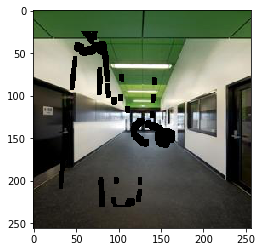

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


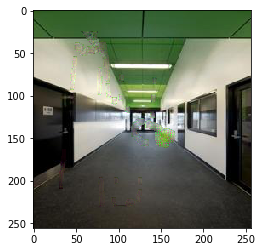

loss: 0.30090439319610596
---------------------------- Epoch 17, Iter 4029


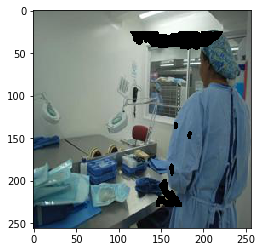

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


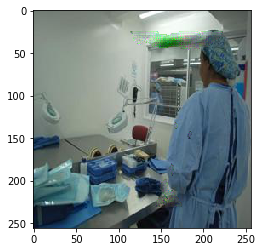

loss: 0.3625374734401703
---------------------------- Epoch 17, Iter 4030


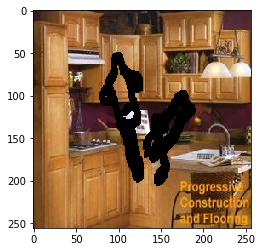

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


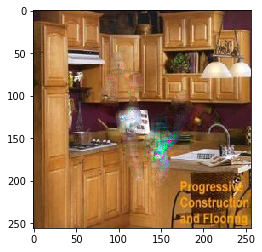

loss: 0.3200331926345825
About to save a model...
---------------------------- Epoch 17, Iter 4031


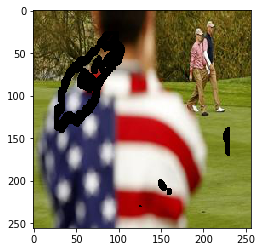

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


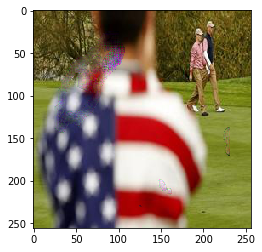

loss: 0.2771003544330597
---------------------------- Epoch 17, Iter 4032


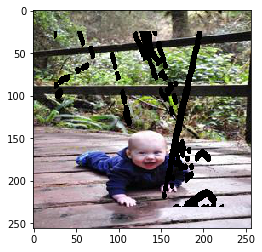

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


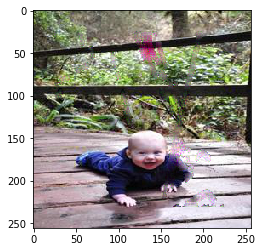

loss: 0.3729502260684967
---------------------------- Epoch 18, Iter 4033


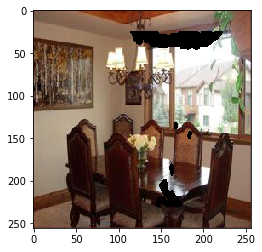

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


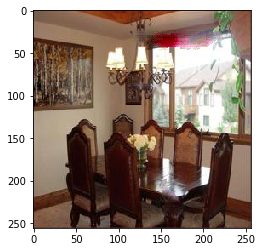

loss: 0.4221818447113037
---------------------------- Epoch 18, Iter 4034


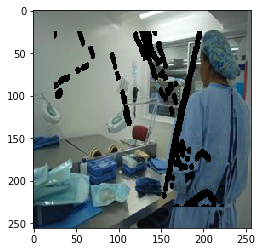

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


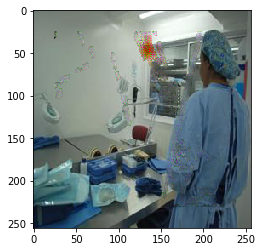

loss: 0.4083658456802368
---------------------------- Epoch 18, Iter 4035


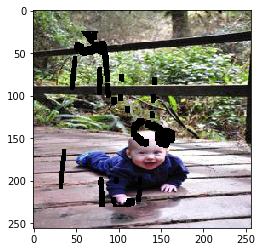

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


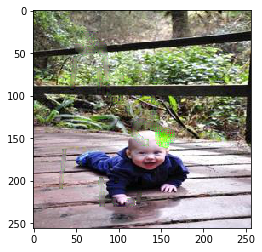

loss: 0.38276296854019165
About to save a model...
---------------------------- Epoch 18, Iter 4036


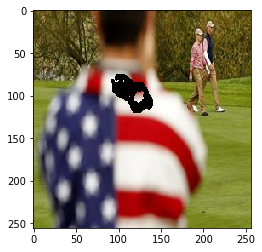

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


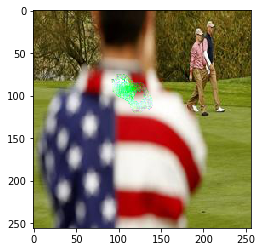

loss: 0.3436114192008972
---------------------------- Epoch 19, Iter 4037


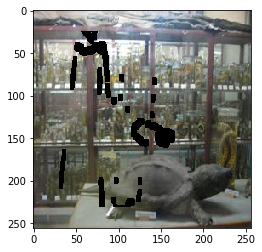

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


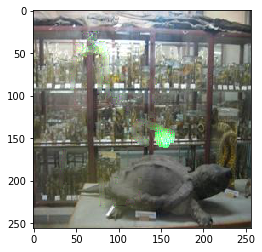

loss: 0.25952914357185364
---------------------------- Epoch 19, Iter 4038


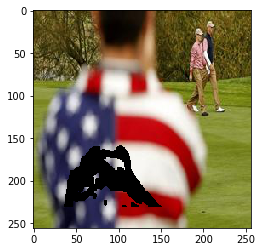

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


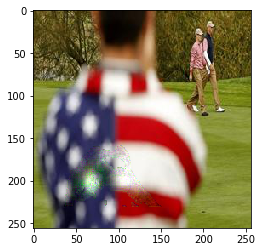

loss: 0.30787786841392517
---------------------------- Epoch 19, Iter 4039


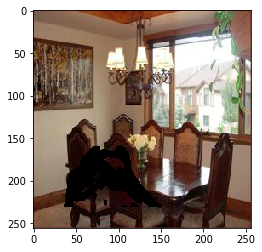

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


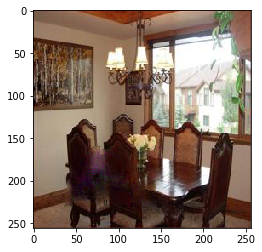

loss: 0.3584183156490326
---------------------------- Epoch 19, Iter 4040


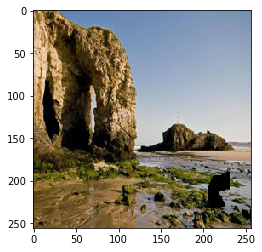

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


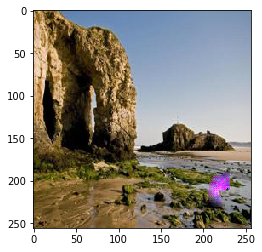

loss: 0.3761235177516937
About to save a model...
---------------------------- Epoch 20, Iter 4041


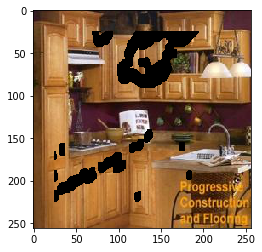

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


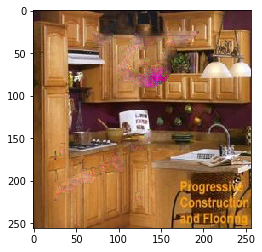

loss: 0.3412027955055237
---------------------------- Epoch 20, Iter 4042


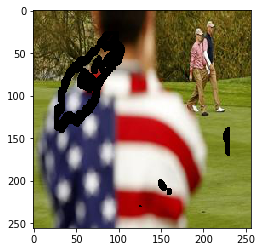

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


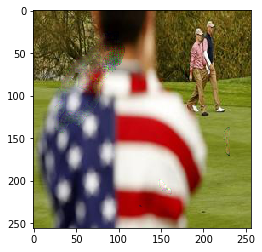

loss: 0.28994718194007874
---------------------------- Epoch 20, Iter 4043


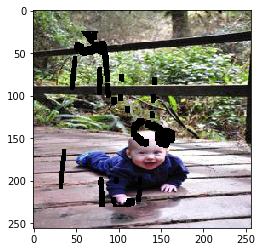

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


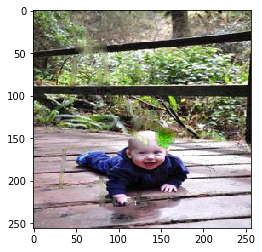

loss: 0.38962921500205994
---------------------------- Epoch 20, Iter 4044


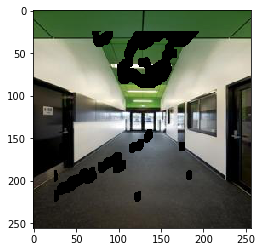

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


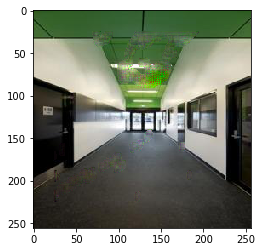

loss: 0.2840447723865509
---------------------------- Epoch 21, Iter 4045


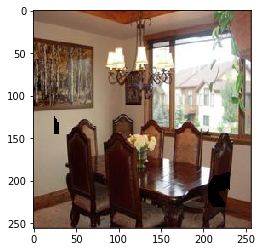

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


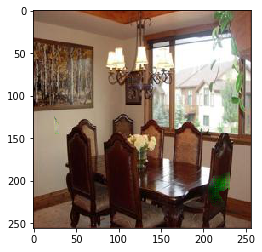

loss: 0.32105860114097595
About to save a model...
---------------------------- Epoch 21, Iter 4046


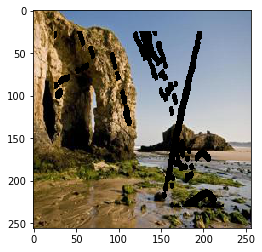

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


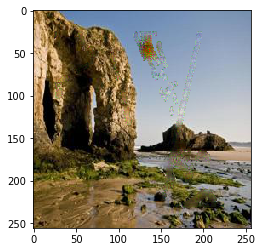

loss: 0.3410276770591736
---------------------------- Epoch 21, Iter 4047


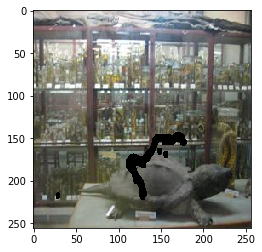

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


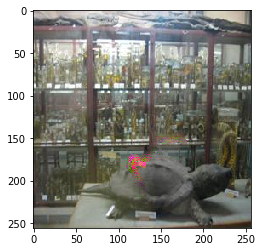

loss: 0.36872735619544983
---------------------------- Epoch 21, Iter 4048


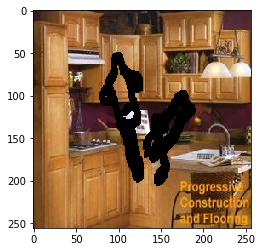

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


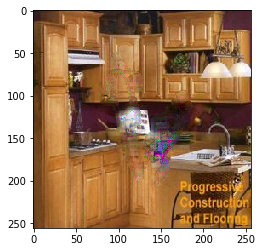

loss: 0.40332844853401184
---------------------------- Epoch 22, Iter 4049


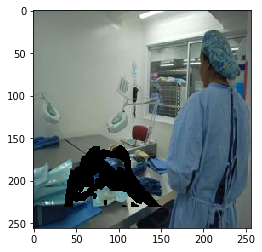

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


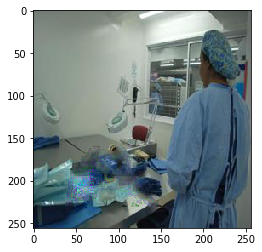

loss: 0.33205875754356384
---------------------------- Epoch 22, Iter 4050


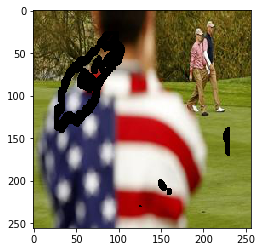

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


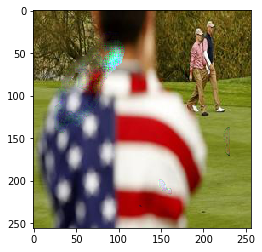

loss: 0.2975413203239441
About to save a model...
---------------------------- Epoch 22, Iter 4051


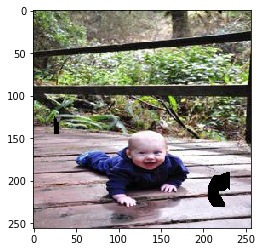

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


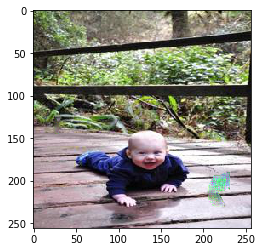

loss: 0.3704383373260498
---------------------------- Epoch 22, Iter 4052


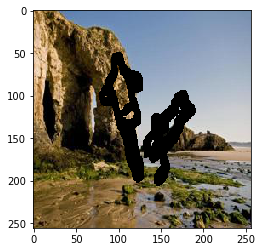

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


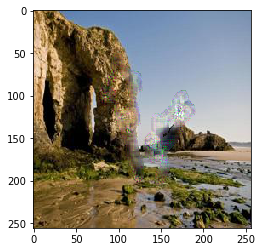

loss: 0.385602205991745
---------------------------- Epoch 23, Iter 4053


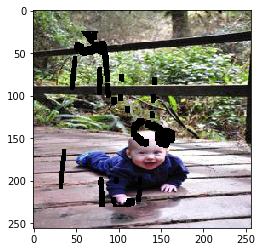

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


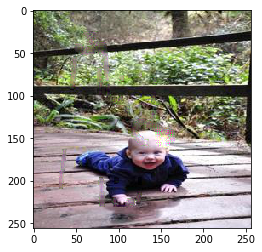

loss: 0.32062187790870667
---------------------------- Epoch 23, Iter 4054


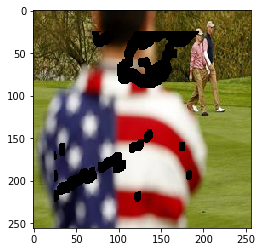

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


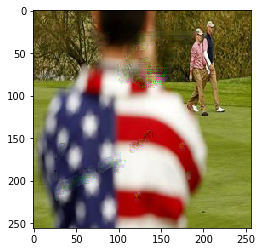

loss: 0.4253283739089966
---------------------------- Epoch 23, Iter 4055


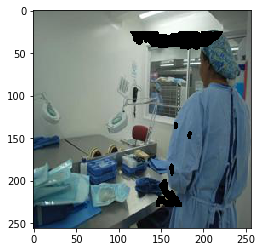

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


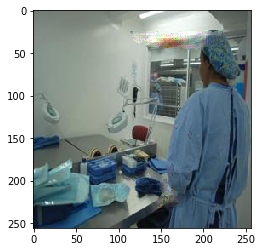

loss: 0.294132798910141
About to save a model...
---------------------------- Epoch 23, Iter 4056


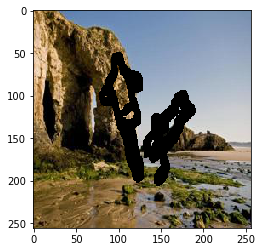

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


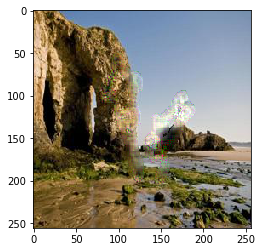

loss: 0.38481462001800537
---------------------------- Epoch 24, Iter 4057


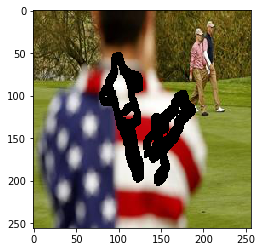

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


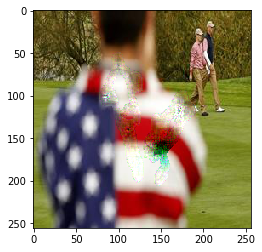

loss: 0.3634464740753174
---------------------------- Epoch 24, Iter 4058


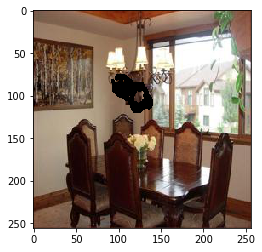

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


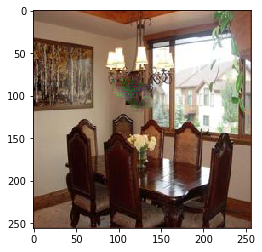

loss: 0.34947633743286133
---------------------------- Epoch 24, Iter 4059


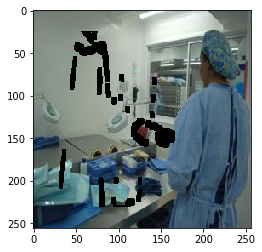

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


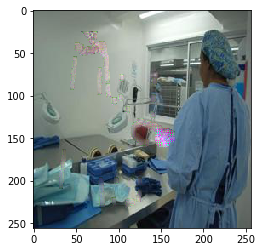

loss: 0.2850203514099121
---------------------------- Epoch 24, Iter 4060


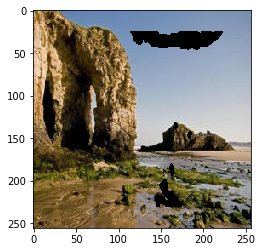

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


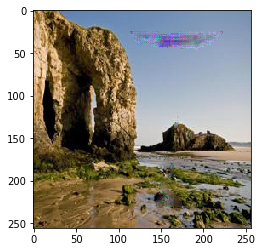

loss: 0.35347628593444824
About to save a model...
---------------------------- Epoch 25, Iter 4061


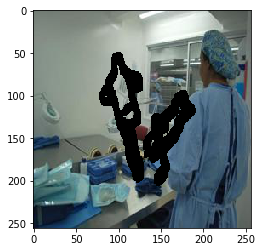

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


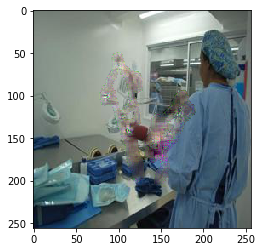

loss: 0.4223951995372772
---------------------------- Epoch 25, Iter 4062


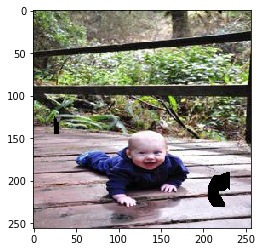

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


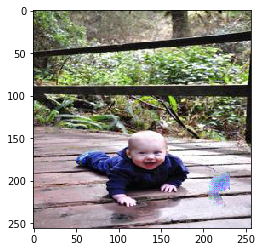

loss: 0.3507138192653656
---------------------------- Epoch 25, Iter 4063


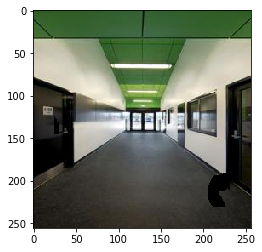

i_comp: 


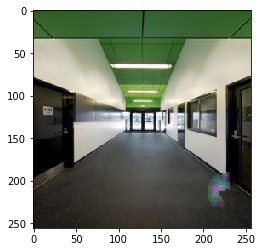

loss: 0.2973777651786804
---------------------------- Epoch 25, Iter 4064


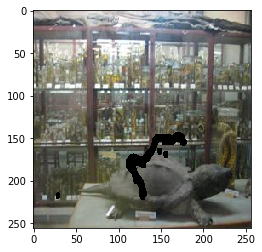

i_comp: 


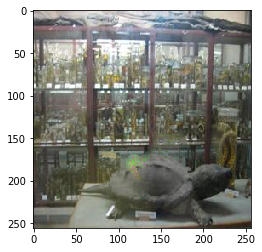

loss: 0.4108181595802307
---------------------------- Epoch 26, Iter 4065


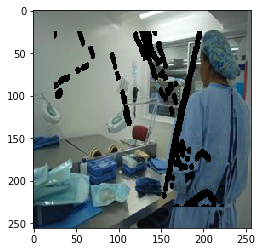

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


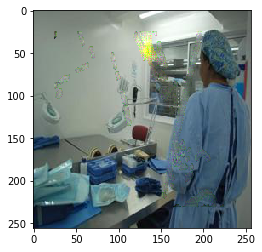

loss: 0.5072017312049866
About to save a model...
---------------------------- Epoch 26, Iter 4066


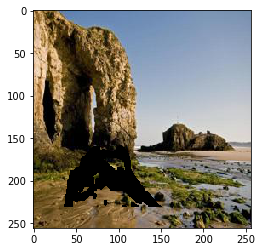

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


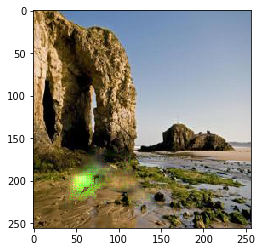

loss: 0.31604650616645813
---------------------------- Epoch 26, Iter 4067


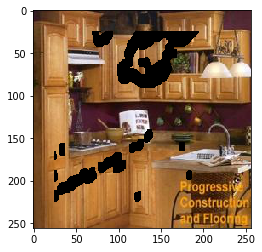

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


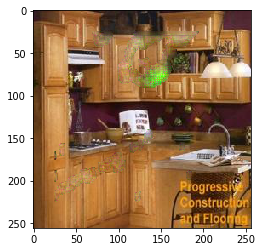

loss: 0.30266010761260986
---------------------------- Epoch 26, Iter 4068


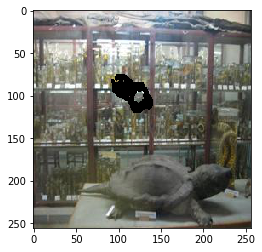

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


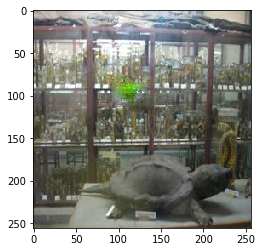

loss: 0.30913659930229187
---------------------------- Epoch 27, Iter 4069


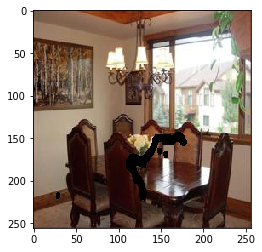

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


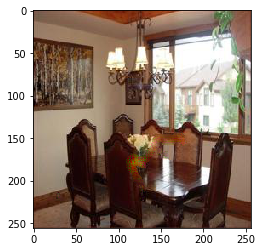

loss: 0.31438395380973816
---------------------------- Epoch 27, Iter 4070


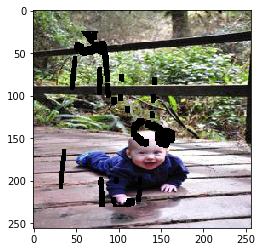

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


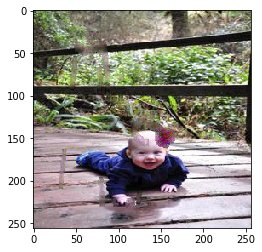

loss: 0.4688931703567505
About to save a model...
---------------------------- Epoch 27, Iter 4071


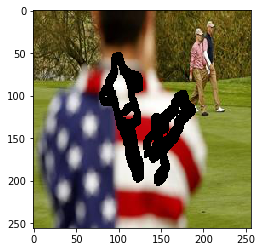

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


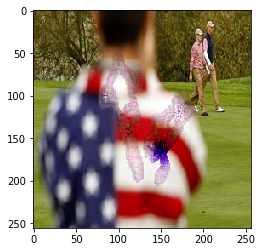

loss: 0.390316367149353
---------------------------- Epoch 27, Iter 4072


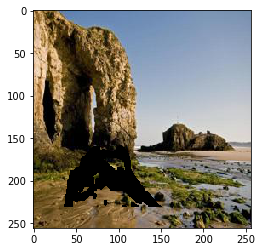

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


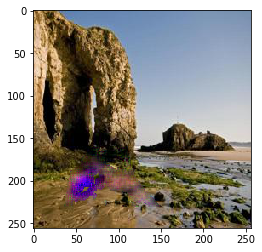

loss: 0.4221455156803131
---------------------------- Epoch 28, Iter 4073


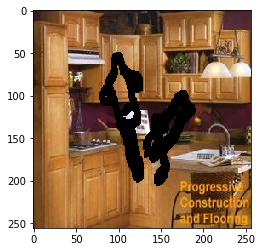

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


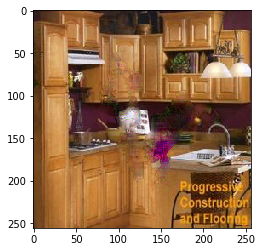

loss: 0.39622485637664795
---------------------------- Epoch 28, Iter 4074


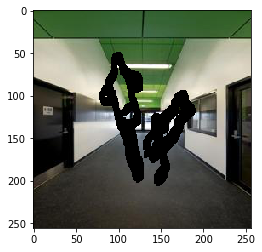

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


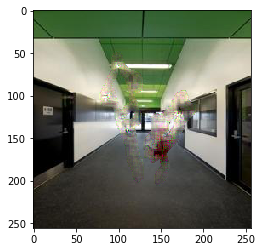

loss: 0.4153073728084564
---------------------------- Epoch 28, Iter 4075


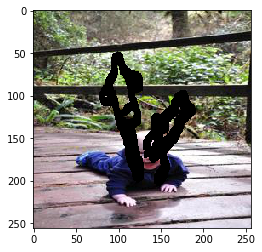

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


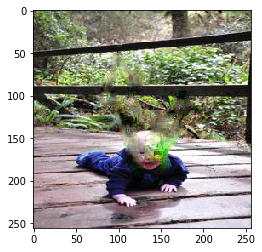

loss: 0.4758535623550415
About to save a model...
---------------------------- Epoch 28, Iter 4076


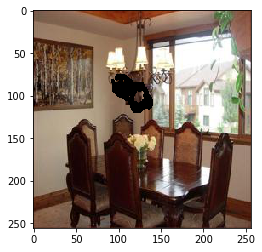

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


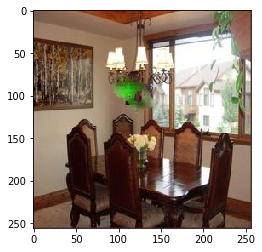

loss: 0.2986071705818176
---------------------------- Epoch 29, Iter 4077


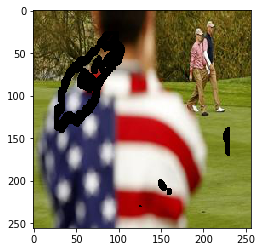

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


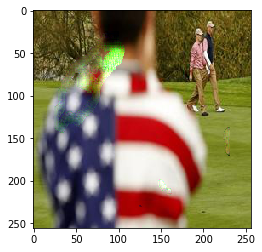

loss: 0.35793304443359375
---------------------------- Epoch 29, Iter 4078


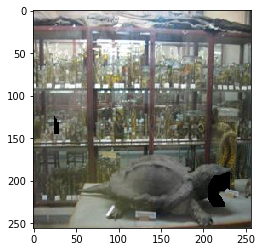

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


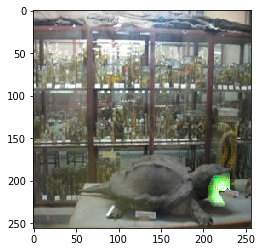

loss: 0.2987218499183655
---------------------------- Epoch 29, Iter 4079


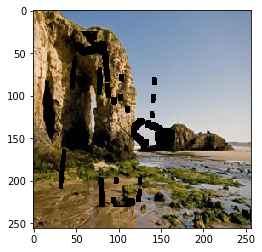

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


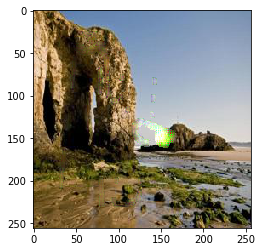

loss: 0.4111771881580353
---------------------------- Epoch 29, Iter 4080


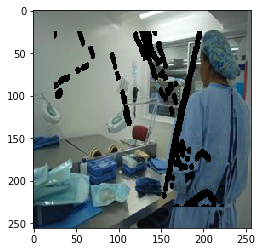

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


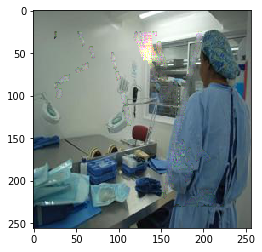

loss: 0.31936976313591003
About to save a model...
---------------------------- Epoch 30, Iter 4081


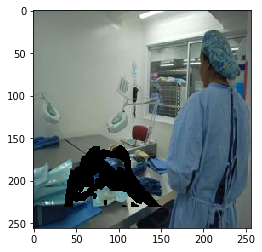

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


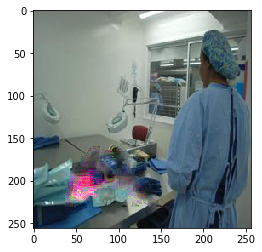

loss: 0.31804734468460083
---------------------------- Epoch 30, Iter 4082


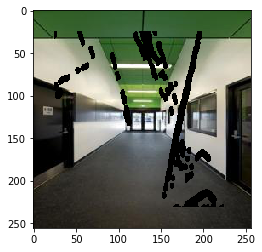

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


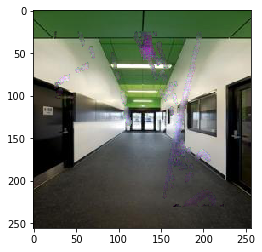

loss: 0.3751398026943207
---------------------------- Epoch 30, Iter 4083


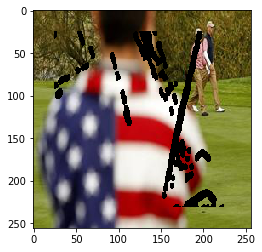

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


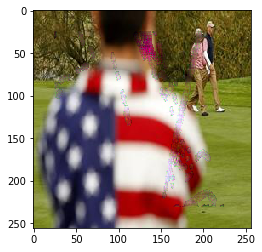

loss: 0.35370680689811707
---------------------------- Epoch 30, Iter 4084


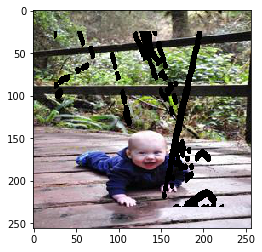

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


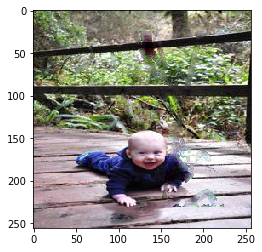

loss: 0.5265346169471741
---------------------------- Epoch 31, Iter 4085


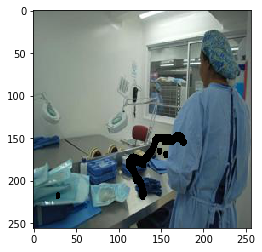

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


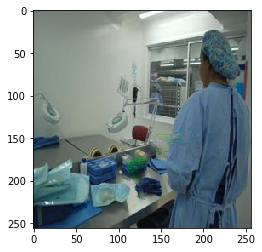

loss: 0.24753761291503906
About to save a model...
---------------------------- Epoch 31, Iter 4086


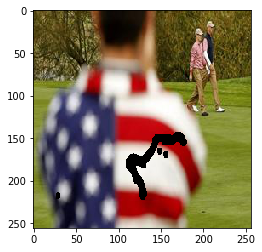

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


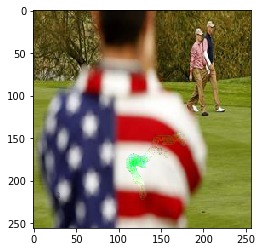

loss: 0.2754712402820587
---------------------------- Epoch 31, Iter 4087


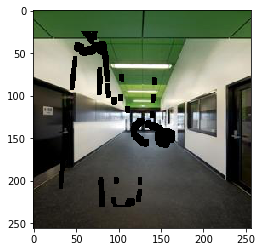

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


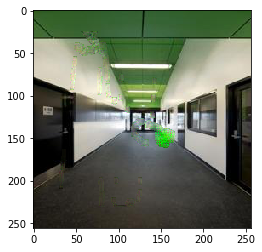

loss: 0.2925778329372406
---------------------------- Epoch 31, Iter 4088


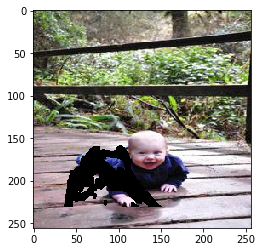

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


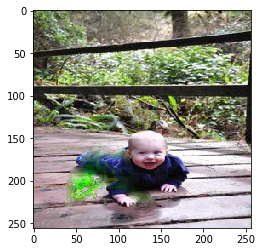

loss: 0.40127673745155334
---------------------------- Epoch 32, Iter 4089


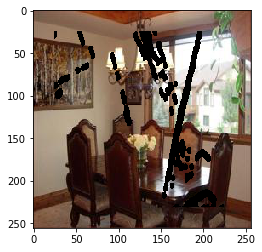

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


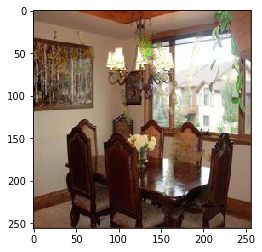

loss: 0.35212403535842896
---------------------------- Epoch 32, Iter 4090


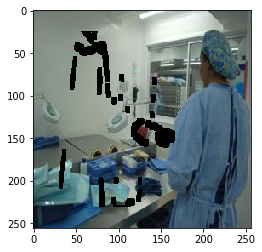

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


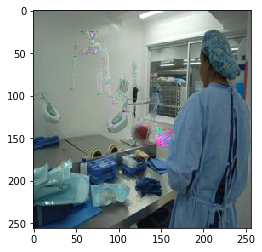

loss: 0.35814130306243896
About to save a model...
---------------------------- Epoch 32, Iter 4091


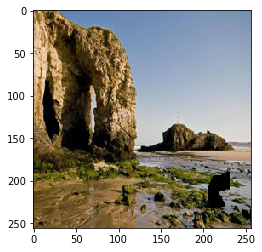

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


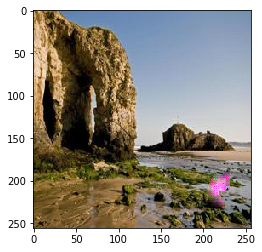

loss: 0.437362939119339
---------------------------- Epoch 32, Iter 4092


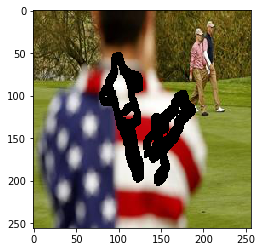

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


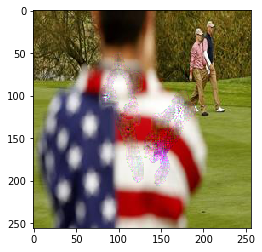

loss: 0.3365255892276764
---------------------------- Epoch 33, Iter 4093


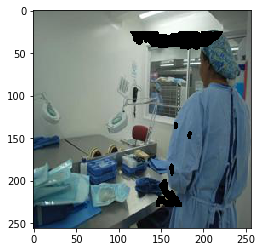

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


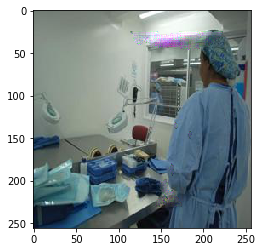

loss: 0.2830241024494171
---------------------------- Epoch 33, Iter 4094


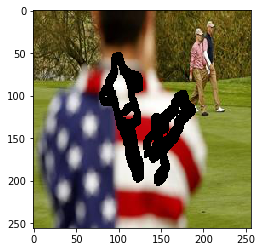

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


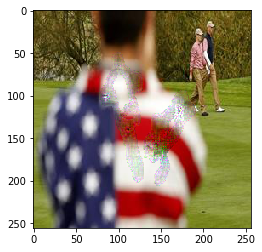

loss: 0.3625599145889282
---------------------------- Epoch 33, Iter 4095


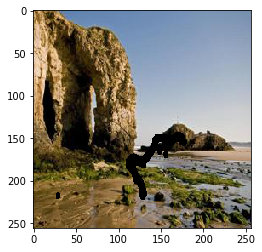

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


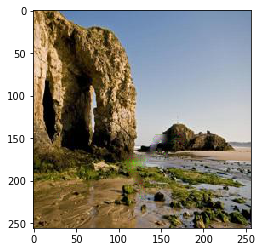

loss: 0.3443872928619385
About to save a model...
---------------------------- Epoch 33, Iter 4096


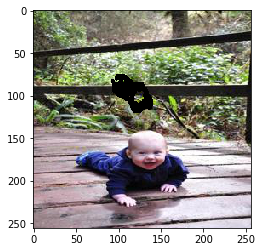

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


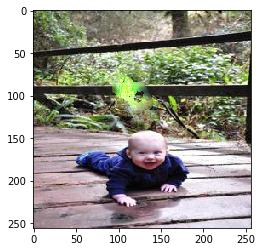

loss: 0.32926395535469055
---------------------------- Epoch 34, Iter 4097


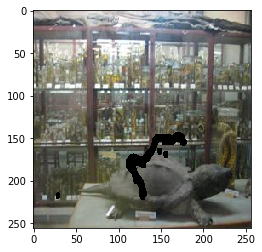

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


i_comp: 


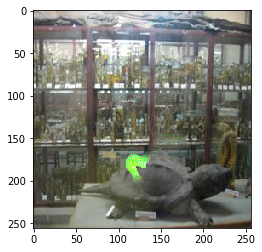

KeyboardInterrupt: ignored

Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe


In [ ]:
def load_model(epochs, save_interval, resume_training, backup_name, mini_code):
    # Define the global objects / params
    bs                 = 2
    lr                 = 0.001
    model              = PConvNetwork(mini_code)
    loss_func          = Compute_Loss()
    t_loader, v_loader = get_data_loaders(bs, True)
    
    torch.autograd.set_detect_anomaly(True)
    t = 1000 # total update counter

    # Resume training check
    if resume_training:
        filename = MODEL_BACKUP_PATH + "/" + backup_name
        assert os.path.isfile(filename), "Model backup path is not a file"
        checkpoint_dict = torch.load(filename)
        
        for key, value in checkpoint_dict['optimizer'].items() :
            print(key)

        model.load_state_dict(checkpoint_dict["model"])
        optimizer = torch.optim.Adam( filter(requires_grad, model.parameters()) , lr=lr )
        optimizer.load_state_dict(checkpoint_dict["optimizer"])
        print("Resume training on model:{}".format(backup_name))
        # Set global counter to resume
        t = int(backup_name.split('.')[0].split('i')[1])
        print('Setting t to ', t)
    
    # Main training loop
    for e in range(epochs):
        for input_x, input_m, gt in iter(t_loader):
            print('---------------------------- Epoch {}, Iter {}'.format(e, t))
            pred_x, pred_m = model(input_x, input_m, mini_code)
            plot_image(input_x[0,0:3,:,:]*input_m[0,0:3,:,:])

            # loss_out = loss_func(input_x.unsqueeze(0), out_x, input_m.unsqueeze(0))
            loss_out = loss_func(pred_x, gt, input_m)
            loss = loss_out['total_loss']

            # Resets gradient accumulator in optimizer
            # back-propogates gradients through model weights
            loss.backward()
            print('loss: {}'.format(loss))
            # updates the weights
            optimizer.step()
            optimizer.zero_grad()
   
            # save the model
            if(t%save_interval == 0):
                print('About to save a model...')
                filename = MODEL_BACKUP_PATH + "/model_ep{}_i{}.pth".format(e, t + 1)
                state = {"model": model.state_dict(), "optimizer": optimizer.state_dict()}
                torch.save(state, filename)
            t = t + 1


def unit_test_load_model():
    epochs            = 50
    save_interval     = 5
    continue_training = True
    backup_name       = "model_ep49_i3961.pth"
    mini_code = False

    load_model(epochs, save_interval, continue_training, backup_name, mini_code)

unit_test_load_model()